In [1]:
import matplotlib as mpl 
import matplotlib.pyplot as plt 
from matplotlib import rcParams 
import numpy as np
import pandas as pd
import scipy

import configparser 
import datetime 
import glob 

from scipy import signal 

import time 
from tqdm import tqdm_notebook 

import sys 
print(sys.version, sys.platform, sys.executable) 

%matplotlib inline 
%config InlineBackend.figure_formats = {'png', 'retina'} 
%alias_magic t time 

mpl.rcParams.update({'font.size': 14})  
mpl.rcParams.update({'axes.facecolor':'w'}) 
mpl.rcParams.update({'axes.edgecolor':'k'}) 
mpl.rcParams.update({'figure.facecolor':'w'}) 
mpl.rcParams.update({'figure.edgecolor':'w'}) 
mpl.rcParams.update({'axes.grid':True}) 
mpl.rcParams.update({'grid.linestyle':':'}) 
mpl.rcParams.update({'figure.figsize':[12,9]}) 
# fig, axs = plt.subplots(figsize=(14,2)) 

3.6.9 (default, Nov  7 2019, 10:44:02) 
[GCC 8.3.0] linux /usr/bin/python3
Created `%t` as an alias for `%time`.
Created `%%t` as an alias for `%%time`.


In [2]:
import mkid_pylibs as klib

%load_ext autoreload
%autoreload 2

In [3]:
## SG FREQ
lo = "5.31GHz"
dir0 = "data_exams_mkid_pylibs/data_ex_optSRONKIDS/data_2ch__2018-1011-140813/"

## SWPDATASET
sfp0 = glob.glob(dir0+"/swp*.rawdata")[0]
## TODDATASET
tfp0 = glob.glob(dir0+'/tod*.rawdata')
print(sfp0)
print(tfp0)

swpset = klib.readfile_swp('rhea',sfp0,-1,lo)
todset = klib.multreadfile_tod('rhea',tfp0,lo)

kr = [
    klib.kidana_psd.PSDAnalyzer(swp=swpset[0], tod=todset[0], ctod=todset[1]),
#    klib.kidana_psd.PSDAnalyzer(swp=swpset[2], tod=todset[2], ctod=todset[3]),
#    klib.kidana_psd.PSDAnalyzer(swp=swpset[4], tod=todset[4], ctod=todset[5]),
]

for ik in kr:
    ik.fitIQ(nfwhm=3)
    ik.calcpsd(dofit=True)

data_exams_mkid_pylibs/data_ex_optSRONKIDS/data_2ch__2018-1011-140813/swp__0.0uW_RF1amp22.0_RF2amp25.0_KID06_5.31GHz_+053.779MHz_+059.779MHz_+000.010MHz_2018-1011-140826.rawdata
['data_exams_mkid_pylibs/data_ex_optSRONKIDS/data_2ch__2018-1011-140813/tod__0.0uW_RF1amp22.0_RF2amp25.0_KID06_5.31GHz_-2.0MHzBlindTone_1000kSPS_+056.777MHz_2018-1011-140911.rawdata', 'data_exams_mkid_pylibs/data_ex_optSRONKIDS/data_2ch__2018-1011-140813/tod__0.0uW_RF1amp22.0_RF2amp25.0_KID06_5.31GHz_-2.0MHzBlindTone_100kSPS_+056.777MHz_2018-1011-140907.rawdata', 'data_exams_mkid_pylibs/data_ex_optSRONKIDS/data_2ch__2018-1011-140813/tod__0.0uW_RF1amp22.0_RF2amp25.0_KID06_5.31GHz_-2.0MHzBlindTone_1kSPS_+056.777MHz_2018-1011-140856.rawdata']
ADD PARAM -> arga                 : <class 'inspect._empty'>
ADD PARAM -> absa                 : <class 'inspect._empty'>
ADD PARAM -> tau                  : <class 'inspect._empty'>
ADD PARAM -> fr                   : <class 'inspect._empty'>
ADD PARAM -> Qr                 

/usr/lib/python3/dist-packages/lmfit/astutils.py:159: RuntimeWarning: divide by zero encountered in double_scalars
  ast.Div: lambda a, b: a / b,


In [4]:
kid=kr[0]

# Basic analysis

In [5]:
kid.swp.fitresult.report()

[[Fit Statistics]]
    # function evals   = 16
    # data points      = 162
    # variables        = 8
    chi-square         = 8.39047273934e-06
    reduced chi-square = 5.44835892165e-08
[[Variables]]
    arga:   156.777877 +/- 24.44618 (15.59%) (init= 2.989212)
    absa:   0.04803682 +/- 7.23e-05 (0.15%) (init= 0.04669977)
    tau:    5.9833e-07 +/- 7.25e-10 (0.12%) (init= 5.937662e-07)
    fr:     5.3668e+09 +/- 1.37e+03 (0.00%) (init= 5.366769e+09)
    Qr:     18579.3167 +/- 176.2011 (0.95%) (init= 19876.92)
    Qc:     54308.0210 +/- 584.7497 (1.08%) (init= 19876.92)
    phi0:  -0.20087970 +/- 0.011125 (5.54%) (init= 0)
    c:      6.9159e-09 +/- 4.55e-09 (65.81%) (init= 0)
    Qi:     27948.5159 +/- 260.9425 (0.93%)  == '1/(1/Qr - 1/Qc*cos(phi0))'
[[Correlations]] (unreported correlations are <  0.100)
    C(arga, tau)                 =  1.000 
    C(Qr, Qc)                    =  0.940 
    C(fr, phi0)                  = -0.937 
    C(absa, Qc)                  = -0.872 
    C(p

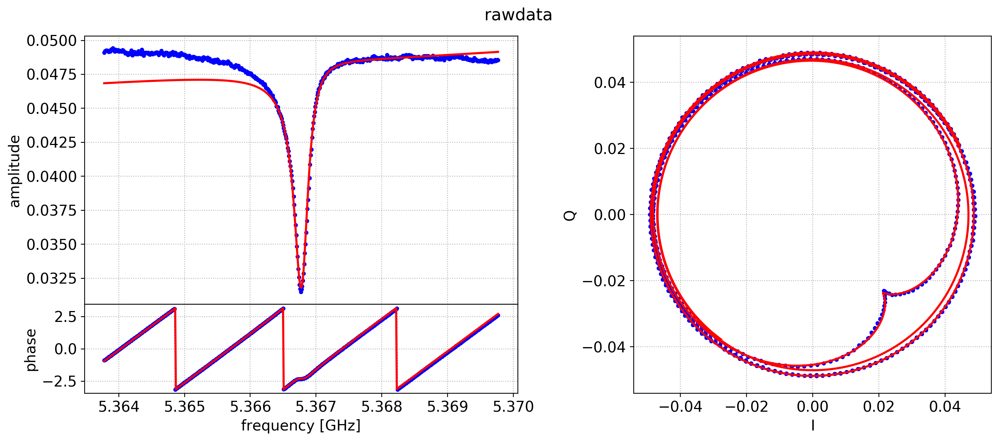

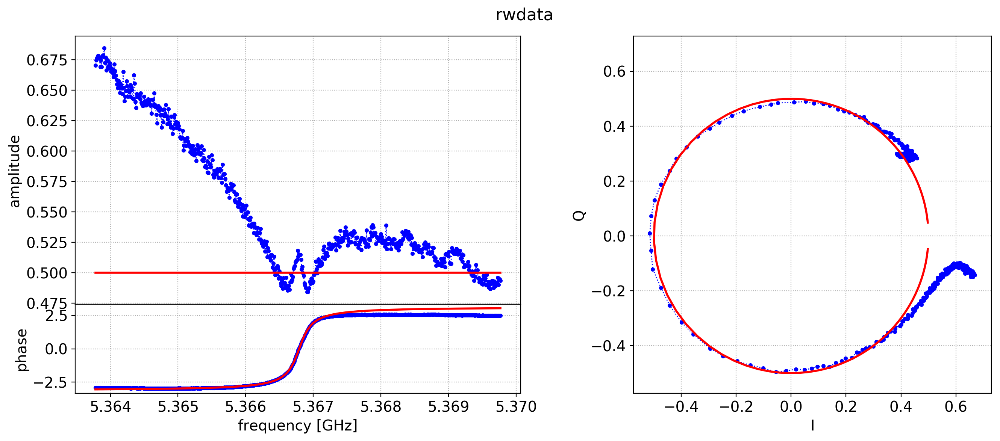

In [6]:
for k in ['raw','rw']:
    fig,ax = klib.plotter.plotSwp(kid.swp,kind=k+'data',title=k+'data',
                                  color='blue',ls=':',lw=1,marker='.')
    klib.plotter.plotSwp(kid.swp,kind='fitdata.'+k+'data',ax=ax,
                         color='red',marker='',lw=2,ls='-',)

(<matplotlib.figure.Figure at 0x7fe710f50978>,
  <matplotlib.axes._subplots.AxesSubplot at 0x7fe70f294e48>])

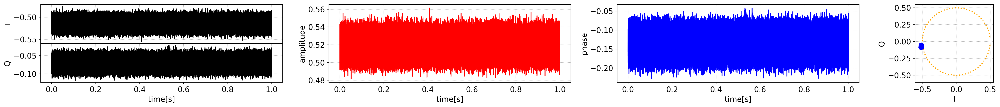

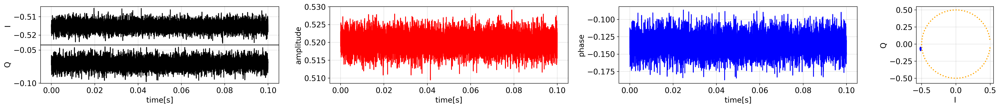

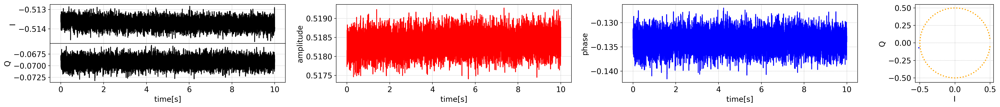

In [7]:
klib.plotter.plotTOD(kid.todlist[2],kind='rwmdata',swpdata=kid.swp.data)
klib.plotter.plotTOD(kid.todlist[1],kind='rwmdata',swpdata=kid.swp.data)
klib.plotter.plotTOD(kid.todlist[0],kind='rwmdata',swpdata=kid.swp.data)

(<matplotlib.figure.Figure at 0x7fe70f43c160>,
  <matplotlib.axes._subplots.AxesSubplot at 0x7fe70f1d1f98>])

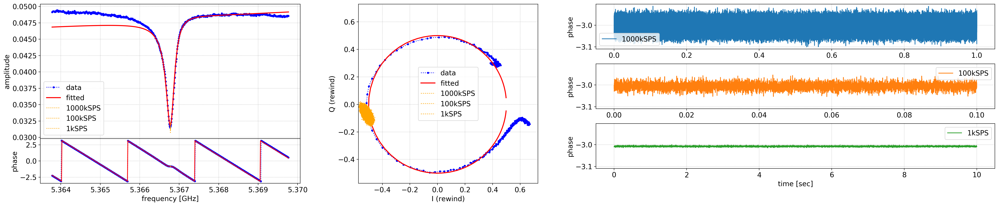

In [8]:
klib.plotter.plotSwpTOD(kid.swp,kid.todlist)

In [9]:
kid.calcpsd()

In [10]:
kid.psdfitresult.report()

[[Fit Statistics]]
    # function evals   = 71
    # data points      = 8044
    # variables        = 5
    chi-square         = 3776.69146219
    reduced chi-square = 0.469796176414
[[Variables]]
    TLSconst:     9.6849e-09 +/- 9.28e-10 (9.58%) (init= 9.473945e-08)
    TLSexp:       0.40022505 +/- 0.014698 (3.67%) (init= 1)
    GRconst:      5.6136e-09 +/- 5.59e-11 (1.00%) (init= 2.80562e-10)
    tqp:          4.3896e-06 +/- 3.39e-08 (0.77%) (init= 2e-06)
    WhiteNoise:   1.7049e-10 +/- 6.80e-12 (3.99%) (init= 1.933219e-10)
[[Correlations]] (unreported correlations are <  0.100)
    C(TLSexp, WhiteNoise)        =  0.901 
    C(TLSconst, TLSexp)          =  0.859 
    C(GRconst, tqp)              =  0.707 
    C(TLSconst, tqp)             = -0.622 
    C(TLSexp, tqp)               = -0.617 
    C(TLSconst, WhiteNoise)      =  0.556 
    C(TLSconst, GRconst)         = -0.523 
    C(tqp, WhiteNoise)           = -0.461 
    C(TLSexp, GRconst)           = -0.229 


(<matplotlib.figure.Figure at 0x7fe70f060ba8>,
  <matplotlib.axes._subplots.AxesSubplot at 0x7fe70eeb9198>])

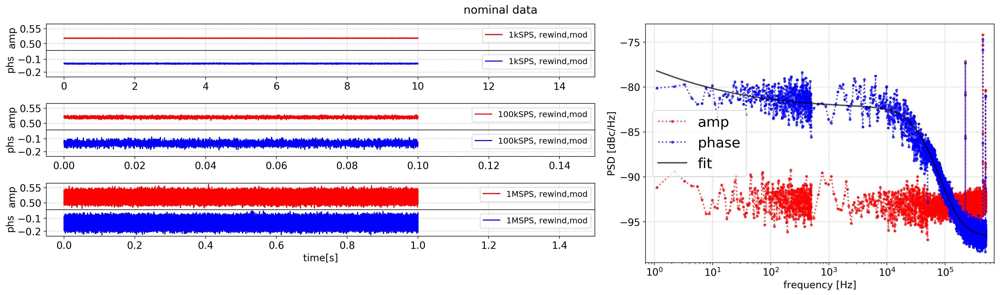

In [11]:
klib.plotter.plotTOD2(kid.todlist,kid.psd,kid.psdfitresult,title='nominal data')

In [12]:
kid.tod.psd.amplitude

array([  1.67865826e-10,   7.64444235e-10,   1.15631504e-09,
         8.97978540e-10,   7.92233000e-10,   7.81944464e-10,
         5.60457641e-10,   3.90174157e-10,   3.89374998e-10,
         5.51089204e-10,   4.61731762e-10,   4.49620731e-10,
         6.62396007e-10,   8.11783384e-10,   7.18572508e-10,
         5.82903235e-10,   3.42394994e-10,   3.97762054e-10,
         4.24507018e-10,   5.24451411e-10,   6.85578772e-10,
         5.49123644e-10,   8.82241442e-10,   1.02568866e-09,
         5.63012971e-10,   4.50157681e-10,   4.36389429e-10,
         5.48672281e-10,   6.59013254e-10,   5.26679367e-10,
         5.78541695e-10,   4.62925344e-10,   3.82205852e-10,
         3.60914207e-10,   4.00738549e-10,   3.98103378e-10,
         5.01283473e-10,   4.80385294e-10,   4.87849990e-10,
         5.06569419e-10,   7.44270520e-10,   1.05996097e-09,
         9.97482819e-10,   6.48518553e-10,   6.81548750e-10,
         5.44234546e-10,   3.87715919e-10,   3.50127610e-10,
         7.18057842e-10,

# Temperature sweep

In [13]:
import os
### for data_ex_optSRONKIDS/

T = 0.20968781221779434 #[K] for kid

dn = 'data_exams_mkid_pylibs/data_ex_optSRONKIDS/'
Tswp_files = [
    dn+'data_2ch__2018-1011-170744/swp__0.0uW_RF1amp22.0_RF2amp25.0_KID06_5.31GHz_+053.772MHz_+059.772MHz_+000.010MHz_2018-1011-170757.rawdata',
    dn+'data_2ch__2018-1011-165242/swp__0.0uW_RF1amp22.0_RF2amp25.0_KID06_5.31GHz_+053.758MHz_+059.758MHz_+000.010MHz_2018-1011-165255.rawdata',
    dn+'data_2ch__2018-1011-142339/swp__0.0uW_RF1amp22.0_RF2amp25.0_KID06_5.31GHz_+053.778MHz_+059.778MHz_+000.010MHz_2018-1011-142352.rawdata',
    dn+'data_2ch__2018-1011-155116/swp__0.0uW_RF1amp22.0_RF2amp25.0_KID06_5.31GHz_+053.652MHz_+059.652MHz_+000.010MHz_2018-1011-155128.rawdata',
    dn+'data_2ch__2018-1011-150954/swp__0.0uW_RF1amp22.0_RF2amp25.0_KID06_5.31GHz_+053.680MHz_+059.680MHz_+000.010MHz_2018-1011-151007.rawdata',
    dn+'data_2ch__2018-1011-163736/swp__0.0uW_RF1amp22.0_RF2amp25.0_KID06_5.31GHz_+053.492MHz_+059.492MHz_+000.010MHz_2018-1011-163749.rawdata',
    dn+'data_2ch__2018-1011-160640/swp__0.0uW_RF1amp22.0_RF2amp25.0_KID06_5.31GHz_+053.579MHz_+059.579MHz_+000.010MHz_2018-1011-160652.rawdata',
    dn+'data_2ch__2018-1011-162209/swp__0.0uW_RF1amp22.0_RF2amp25.0_KID06_5.31GHz_+053.561MHz_+059.561MHz_+000.010MHz_2018-1011-162222.rawdata',
    dn+'data_2ch__2018-1011-140813/swp__0.0uW_RF1amp22.0_RF2amp25.0_KID06_5.31GHz_+053.779MHz_+059.779MHz_+000.010MHz_2018-1011-140826.rawdata',
    dn+'data_2ch__2018-1011-143903/swp__0.0uW_RF1amp22.0_RF2amp25.0_KID06_5.31GHz_+053.775MHz_+059.775MHz_+000.010MHz_2018-1011-143916.rawdata',
    dn+'data_2ch__2018-1011-145429/swp__0.0uW_RF1amp22.0_RF2amp25.0_KID06_5.31GHz_+053.733MHz_+059.733MHz_+000.010MHz_2018-1011-145442.rawdata',
]

Tswp_temps = [
    0.25074814317359834,
    0.2914201404975535,
    0.21767800139278862,
    0.3381137580080448,
    0.3296872909109462,
    0.3630744075579845,
    0.3530849082626251,
    0.3531586061770769,
    0.20968781221779434,
    0.2633075187992045,
    0.314944882291794,
]

tmpary = zip(Tswp_temps,Tswp_files)
Tswp_temps,Tswp_files = zip(*sorted(tmpary,reverse=True))

Ttod_files = [max(glob.glob(os.path.dirname(ff)+'/tod__*1000kSPS*.rawdata'), key=os.path.getctime) for ff in Tswp_files]

In [14]:
# input KID property
V = 135 #[um3]

In [15]:
tswp = klib.SweepMeas()
tswp.sweepVar(Tswp_temps, 'temp', renew=True)
tswp.sweepVar(klib.misc.convert_Kelvin_nqp(np.array(Tswp_temps)), 'nqp', renew=True)
tswp.sweepVar(klib.misc.convert_Kelvin_nqp(np.array(Tswp_temps)) * V, 'Nqp', renew=True)

00 (   0.363 K) SWP: swp__0.0uW_RF1amp22.0_RF2amp25.0_KID06_5.31GHz_+053.492MHz_+059.492MHz_+000.010MHz_2018-1011-163749.rawdata
00 (   0.363 K) TOD: tod__0.0uW_RF1amp22.0_RF2amp25.0_KID06_5.31GHz_-2.0MHzBlindTone_1000kSPS_+056.501MHz_2018-1011-163834.rawdata
01 (   0.353 K) SWP: swp__0.0uW_RF1amp22.0_RF2amp25.0_KID06_5.31GHz_+053.561MHz_+059.561MHz_+000.010MHz_2018-1011-162222.rawdata
01 (   0.353 K) TOD: tod__0.0uW_RF1amp22.0_RF2amp25.0_KID06_5.31GHz_-2.0MHzBlindTone_1000kSPS_+056.565MHz_2018-1011-162307.rawdata
02 (   0.353 K) SWP: swp__0.0uW_RF1amp22.0_RF2amp25.0_KID06_5.31GHz_+053.579MHz_+059.579MHz_+000.010MHz_2018-1011-160652.rawdata
02 (   0.353 K) TOD: tod__0.0uW_RF1amp22.0_RF2amp25.0_KID06_5.31GHz_-2.0MHzBlindTone_1000kSPS_+056.581MHz_2018-1011-160738.rawdata
03 (   0.338 K) SWP: swp__0.0uW_RF1amp22.0_RF2amp25.0_KID06_5.31GHz_+053.652MHz_+059.652MHz_+000.010MHz_2018-1011-155128.rawdata
03 (   0.338 K) TOD: tod__0.0uW_RF1amp22.0_RF2amp25.0_KID06_5.31GHz_-2.0MHzBlindTone_1000kS

(<matplotlib.figure.Figure at 0x7fe70f065a90>,
  <matplotlib.axes._subplots.AxesSubplot at 0x7fe70f3ea080>])

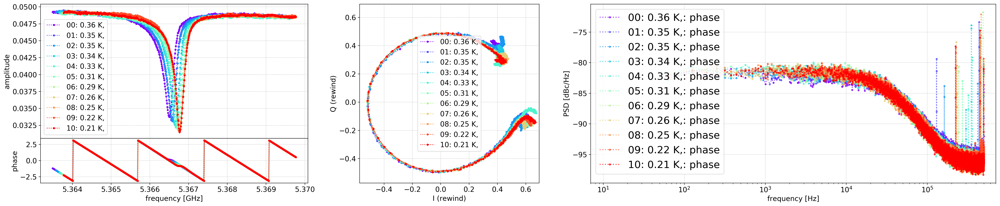

In [16]:
tswp.sweepVar_readfromfile('rhea',Tswp_files,lo,0,1,inpath_tod=Ttod_files,nmax=1e4,label='temp[K]',dopsd='phs',plotted=True,renew=True)

In [17]:
tswp.sweepVar(klib.misc.convert_tqp_nqp(tswp.get_vals('psdphs_tqp')), 'rolloff_nqp', renew = True)
tswp.sweepVar(klib.misc.convert_tqp_nqp(tswp.get_vals('psdphs_tqp'))*V, 'rolloff_Nqp', renew = True)

In [18]:
tswp.print_params()

temp
nqp
Nqp
swp_arga
swp_absa
swp_tau
swp_fr
swp_Qr
swp_Qc
swp_phi0
swp_c
swp_Qi
psdphs_TLSconst
psdphs_TLSexp
psdphs_GRconst
psdphs_tqp
psdphs_WhiteNoise
rolloff_nqp
rolloff_Nqp


In [19]:
tswp.get_vals('Nqp')

array([ 1916300.08042145,  1589391.83996475,  1587123.72034442,
        1172801.50742603,   977725.17228383,   695313.76892122,
         376715.47440859,   157625.58054227,   100458.48835377,
          24096.45898249,    15979.47766381])

ADD PARAM -> a                    : -0.13606605840037897
ADD PARAM -> b                    : 5366793946.039663
ADD PARAM -> c                    : 783048.3244829662
[[Fit Statistics]]
    # function evals   = 15
    # data points      = 11
    # variables        = 3
    chi-square         = 307.070556072
    reduced chi-square = 38.383819509
    p-value            = 1.28665592308e-61
[[Variables]]
    a:  -0.16725744 +/- 0.008724 (5.22%) (init=-0.1360661)
    b:   5.3669e+09 +/- 1.13e+04 (0.00%) (init= 5.366794e+09)
    c:   4.8120e+05 +/- 4.97e+04 (10.33%) (init= 783048.3)
[[Correlations]] (unreported correlations are <  0.100)
    C(a, b)                      = -0.952 
    C(b, c)                      =  0.881 
    C(a, c)                      = -0.791 


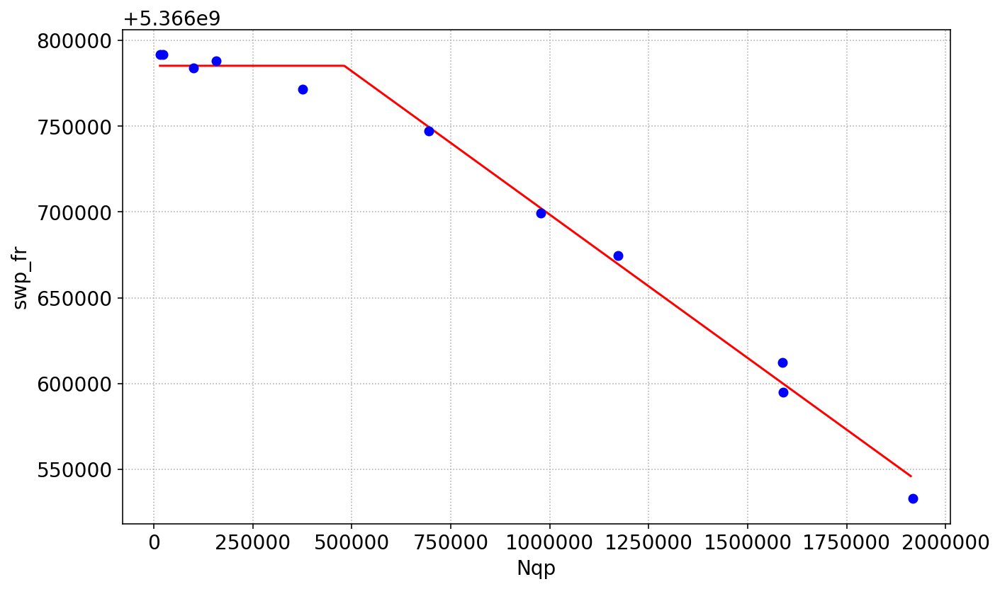

In [20]:
fitres__dfr_dnqp = tswp.fit_linear('Nqp','swp_fr',plotted=True,fitname='c+lin')[0]

ADD PARAM -> a                    : 3.2215438566342214e-12
ADD PARAM -> b                    : 3.572859650923938e-05
ADD PARAM -> c                    : 783048.3244829662
[[Fit Statistics]]
    # function evals   = 18
    # data points      = 11
    # variables        = 3
    chi-square         = 2.72767058083
    reduced chi-square = 0.340958822604
    p-value            = 0.950268825218
[[Variables]]
    a:   4.2513e-12 +/- 2.10e-13 (4.93%) (init= 3.221544e-12)
    b:   3.3752e-05 +/- 2.69e-07 (0.80%) (init= 3.57286e-05)
    c:   5.1098e+05 +/- 4.49e+04 (8.79%) (init= 783048.3)
[[Correlations]] (unreported correlations are <  0.100)
    C(a, b)                      = -0.951 
    C(b, c)                      = -0.877 
    C(a, c)                      =  0.780 


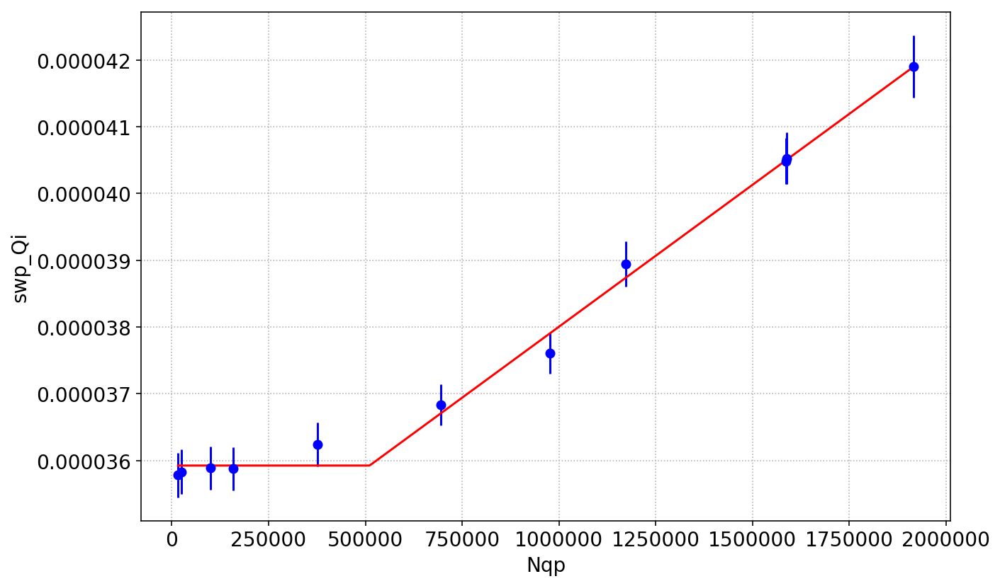

In [21]:
fitres__d1overQi_dnqp = tswp.fit_linear('Nqp','swp_Qi',y_invert=True,plotted=True,fitname='c+lin')[0]

In [22]:
kid.psdfitresult

In [23]:
nepdata = klib.nep.calc_nep(kid.psd,
                            fitres__dfr_dnqp.params['a'].value,
                            fitres__d1overQi_dnqp.params['a'].value,
                            kid.swp.fitresult,
                            #volume=V,
                            #T=T,
                            tqp=kid.psdfitresult.params['tqp'].value,
                            Nqp=klib.misc.convert_Kelvin_nqp(np.array(T))*V,
                           )

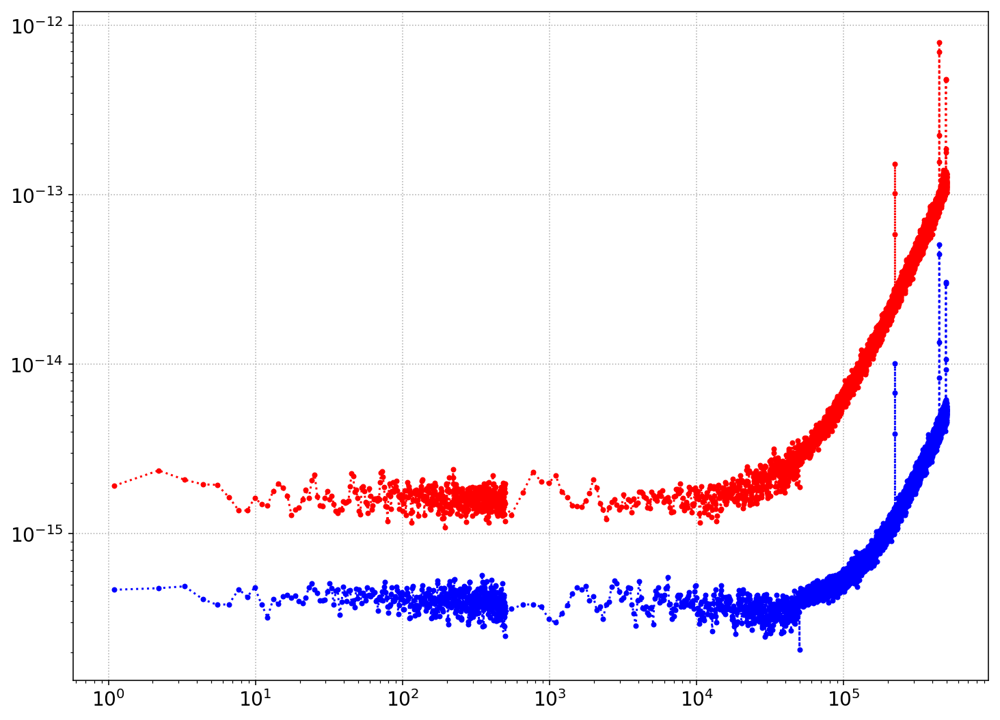

In [24]:
plt.loglog(nepdata.f,nepdata.amplitude,'r:.')
plt.loglog(nepdata.f,nepdata.phase,'b:.')

# Trigger measurement

## Preparation

In [25]:
## SWPDATASET
swp_fp = "data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/swp_0.0uW_KID02_4.99GHz_+030.070MHz_+033.070MHz_+000.010MHz_2018-0515-002105.rawdata"

## TODDATASET
tod_fp = [ x for x in glob.glob(os.path.dirname(swp_fp)+'/tod_*.rawdata') if 'GHz_trg' not in x ]

## EACH DATA HAS MULTIPLE IQ DATA
## SHONDA'S SCRIPT ASSUMING even# data (0,2,...) = KID-tone, odd# data (1,3,...) = off-tone of one before KID

## SG FREQ
lo = "4.99GHz"

print(swp_fp)
print(tod_fp)

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/swp_0.0uW_KID02_4.99GHz_+030.070MHz_+033.070MHz_+000.010MHz_2018-0515-002105.rawdata
['data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_+031.577MHz_2018-0515-002134.rawdata', 'data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_+031.577MHz_2018-0515-002147.rawdata', 'data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_+031.577MHz_2018-0515-002145.rawdata']


In [26]:
ls data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/

swp_0.0uW_KID02_4.99GHz_+030.070MHz_+033.070MHz_+000.010MHz_2018-0515-002105.rawdata
tod_0.0uW_KID02_4.99GHz_+031.577MHz_2018-0515-002134.rawdata
tod_0.0uW_KID02_4.99GHz_+031.577MHz_2018-0515-002145.rawdata
tod_0.0uW_KID02_4.99GHz_+031.577MHz_2018-0515-002147.rawdata
tod_0.0uW_KID02_4.99GHz_trg0000_+031.577MHz_2018-0515-002150.rawdata
tod_0.0uW_KID02_4.99GHz_trg0001_+031.577MHz_2018-0515-002208.rawdata
tod_0.0uW_KID02_4.99GHz_trg0002_+031.577MHz_2018-0515-002322.rawdata
tod_0.0uW_KID02_4.99GHz_trg0003_+031.577MHz_2018-0515-002335.rawdata
tod_0.0uW_KID02_4.99GHz_trg0004_+031.577MHz_2018-0515-002339.rawdata
tod_0.0uW_KID02_4.99GHz_trg0005_+031.577MHz_2018-0515-002353.rawdata
tod_0.0uW_KID02_4.99GHz_trg0006_+031.577MHz_2018-0515-002432.rawdata
tod_0.0uW_KID02_4.99GHz_trg0007_+031.577MHz_2018-0515-002438.rawdata
tod_0.0uW_KID02_4.99GHz_trg0008_+031.577MHz_2018-0515-002456.rawdata
tod_0.0uW_KID02_4.99GHz_trg0009_+031.577MHz_2018-0515-002520.rawdata
tod_0.0uW_KID02_4.99GHz_trg0010_+031.577MH

In [27]:
## SG FREQ
lo = "5.31GHz"
dir0 = "data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/"

## SWPDATASET
sfp0 = glob.glob(dir0+"/swp*.rawdata")[0]
## TODDATASET
tfp0 = [x for x in glob.glob(dir0+'/tod*.rawdata') if 'GHz_trg' not in x ]

swpset = klib.readfile_swp('rhea',sfp0,-1,lo)
todset = klib.multreadfile_tod('rhea',tfp0,lo)

kr = [
    klib.kidana_psd.PSDAnalyzer(swp=swpset[0], tod=todset[0], ctod=todset[1]),
]

for ik in kr:
    ik.fitIQ(nfwhm=3)
    ik.calcpsd(dofit=True)
kid = kr[0]

ADD PARAM -> arga                 : <class 'inspect._empty'>
ADD PARAM -> absa                 : <class 'inspect._empty'>
ADD PARAM -> tau                  : <class 'inspect._empty'>
ADD PARAM -> fr                   : <class 'inspect._empty'>
ADD PARAM -> Qr                   : <class 'inspect._empty'>
ADD PARAM -> Qc                   : <class 'inspect._empty'>
ADD PARAM -> phi0                 : <class 'inspect._empty'>
ADD PARAM -> c                    : <class 'inspect._empty'>
ADD PARAM DEFAULT -> arga                 : 2.1583416355634437
ADD PARAM DEFAULT -> absa                 : 0.03491092854144186
ADD PARAM DEFAULT -> tau                  : 6.329560881424517e-07
ADD PARAM DEFAULT -> fr                   : 5341570000.0
ADD PARAM DEFAULT -> Qr                   : 59350.77777777778
ADD PARAM DEFAULT -> Qc                   : 59350.77777777778
ADD PARAM DEFAULT -> phi0                 : 0
ADD PARAM DEFAULT -> c                    : 0
ADD PARAM DEFAULT -> Qi                   : <P

(<matplotlib.figure.Figure at 0x7fe713350fd0>,
  <matplotlib.axes._subplots.AxesSubplot at 0x7fe7435187f0>])

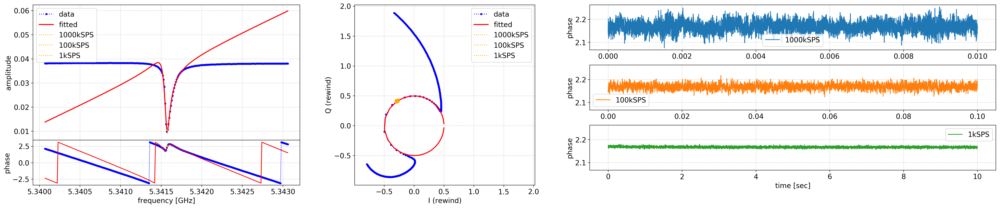

In [28]:
klib.plotter.plotSwpTOD(kid.swp,kid.todlist)

(<matplotlib.figure.Figure at 0x7fe743578978>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7fe74356bb70>)

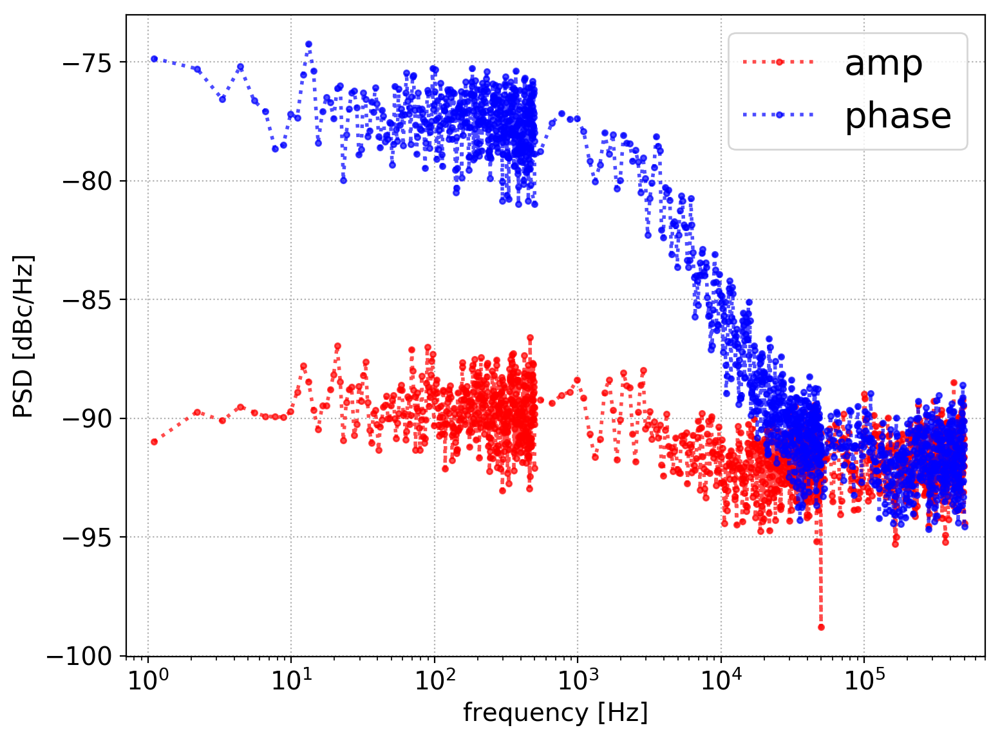

In [29]:
klib.plotter.plotPSD(kid.psd)

## Manual analysis

In [30]:
Trig_files = glob.glob(dir0+'/tod*_trg*rawdata')
Trig_files.sort()

ADD PARAM -> arga                 : <class 'inspect._empty'>
ADD PARAM -> absa                 : <class 'inspect._empty'>
ADD PARAM -> tau                  : <class 'inspect._empty'>
ADD PARAM -> fr                   : <class 'inspect._empty'>
ADD PARAM -> Qr                   : <class 'inspect._empty'>
ADD PARAM -> Qc                   : <class 'inspect._empty'>
ADD PARAM -> phi0                 : <class 'inspect._empty'>
ADD PARAM -> c                    : <class 'inspect._empty'>
ADD PARAM DEFAULT -> arga                 : 2.1583416355634437
ADD PARAM DEFAULT -> absa                 : 0.03491092854144186
ADD PARAM DEFAULT -> tau                  : 6.329560881424517e-07
ADD PARAM DEFAULT -> fr                   : 5341570000.0
ADD PARAM DEFAULT -> Qr                   : 59350.77777777778
ADD PARAM DEFAULT -> Qc                   : 59350.77777777778
ADD PARAM DEFAULT -> phi0                 : 0
ADD PARAM DEFAULT -> c                    : 0
ADD PARAM DEFAULT -> Qi                   : <P

(<matplotlib.figure.Figure at 0x7fe6ff15be10>,
  <matplotlib.axes._subplots.AxesSubplot at 0x7fe7433fd860>])

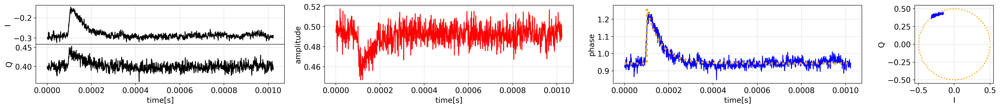

In [31]:
ff = Trig_files[310]
todset = klib.readfile_tod('rhea',ff,-1,lo)
trgkid = klib.kidana.KidAnalyzer(swp=kid.swp, tod=todset[0], ctod=todset[1])
trgkid.fitIQ()
trgkid.fittrig()
klib.plotter.plotTOD(trgkid.tod,kind='rwmdata',trgft=trgkid.trgfitresult,swpdata=kid.swp)

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0000_+031.577MHz_2018-0515-002150.rawdata


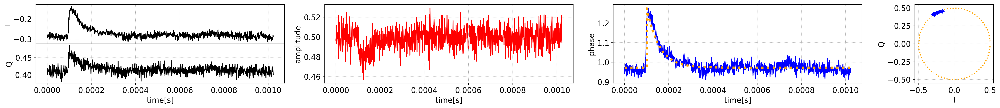

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0001_+031.577MHz_2018-0515-002208.rawdata


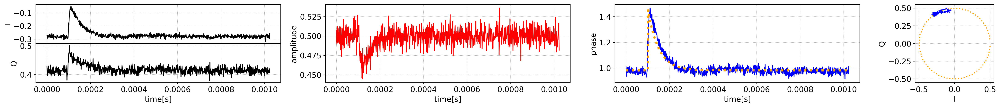

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0002_+031.577MHz_2018-0515-002322.rawdata


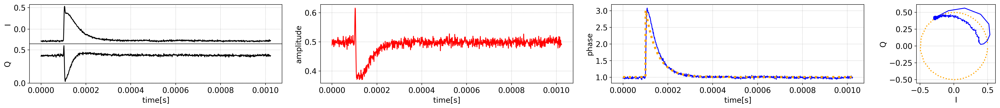

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0003_+031.577MHz_2018-0515-002335.rawdata


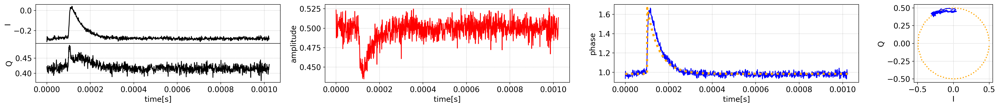

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0004_+031.577MHz_2018-0515-002339.rawdata


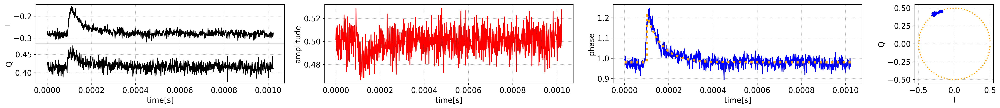

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0005_+031.577MHz_2018-0515-002353.rawdata


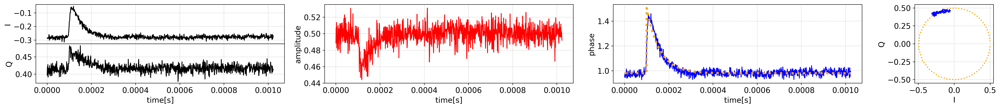

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0006_+031.577MHz_2018-0515-002432.rawdata


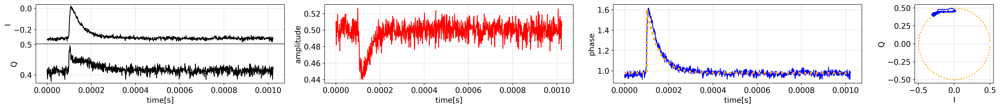

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0007_+031.577MHz_2018-0515-002438.rawdata


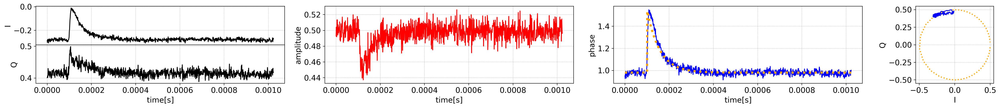

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0008_+031.577MHz_2018-0515-002456.rawdata


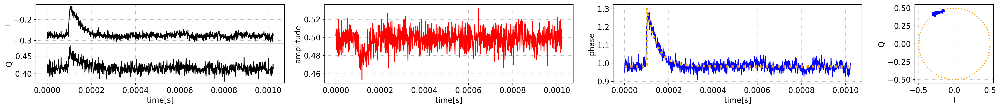

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0009_+031.577MHz_2018-0515-002520.rawdata


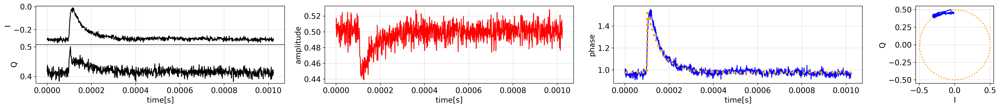

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0010_+031.577MHz_2018-0515-002625.rawdata


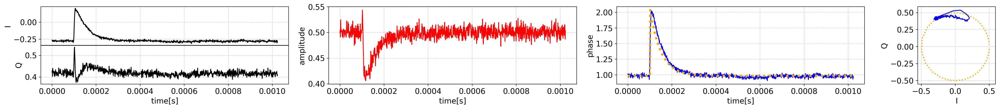

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0011_+031.577MHz_2018-0515-002631.rawdata


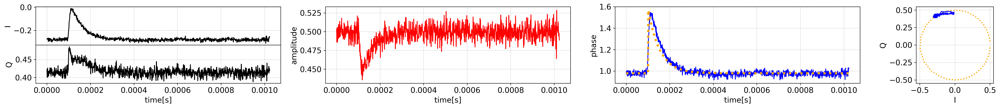

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0012_+031.577MHz_2018-0515-002703.rawdata


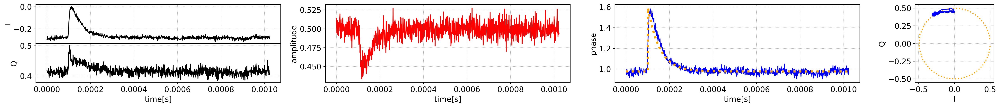

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0013_+031.577MHz_2018-0515-002716.rawdata


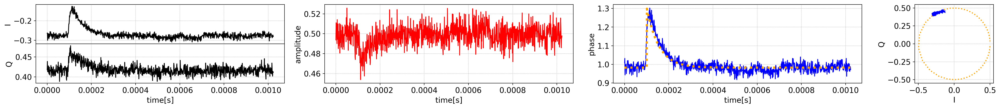

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0014_+031.577MHz_2018-0515-002813.rawdata


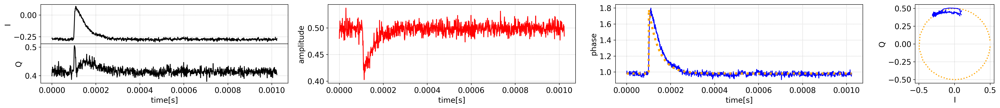

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0015_+031.577MHz_2018-0515-002850.rawdata


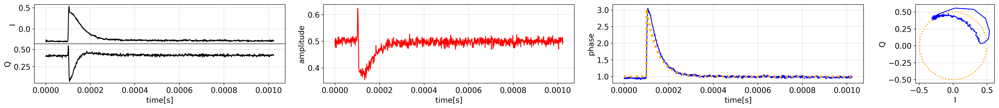

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0016_+031.577MHz_2018-0515-002932.rawdata


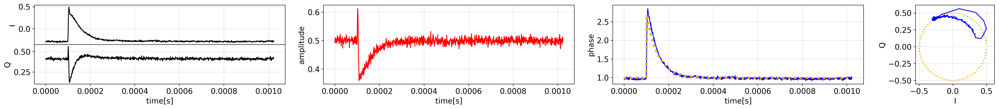

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0017_+031.577MHz_2018-0515-002953.rawdata


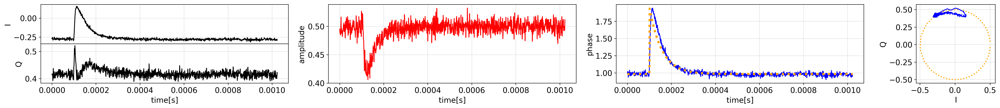

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0018_+031.577MHz_2018-0515-003049.rawdata


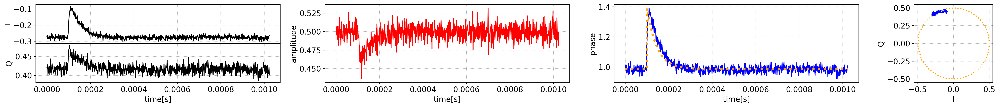

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0019_+031.577MHz_2018-0515-003123.rawdata


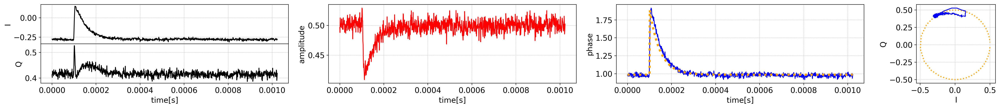

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0020_+031.577MHz_2018-0515-003134.rawdata


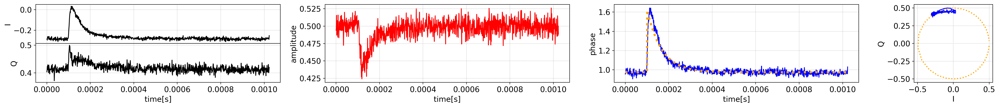

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0021_+031.577MHz_2018-0515-003255.rawdata


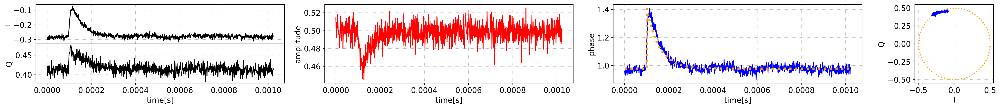

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0022_+031.577MHz_2018-0515-003349.rawdata


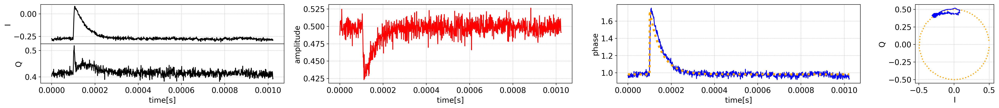

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0023_+031.577MHz_2018-0515-003408.rawdata


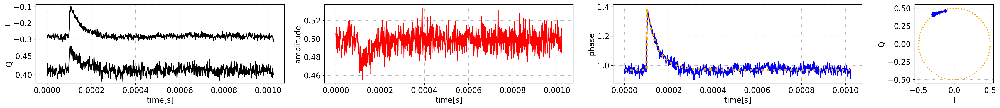

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0024_+031.577MHz_2018-0515-003445.rawdata


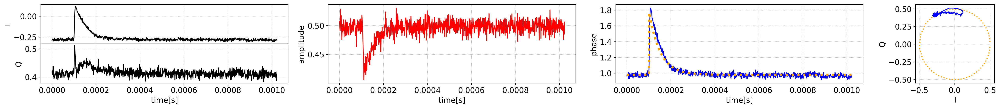

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0025_+031.577MHz_2018-0515-003513.rawdata


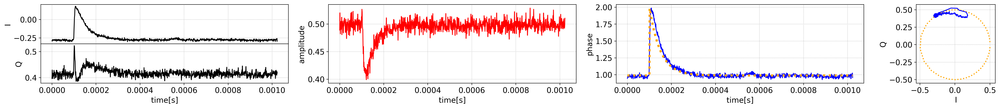

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0026_+031.577MHz_2018-0515-003533.rawdata


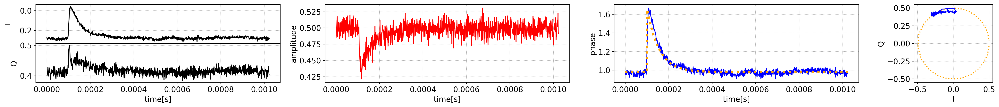

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0027_+031.577MHz_2018-0515-003552.rawdata


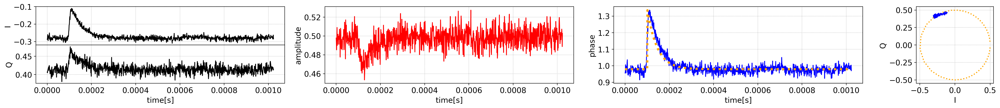

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0028_+031.577MHz_2018-0515-003608.rawdata


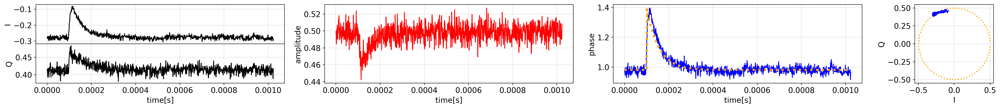

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0029_+031.577MHz_2018-0515-003653.rawdata


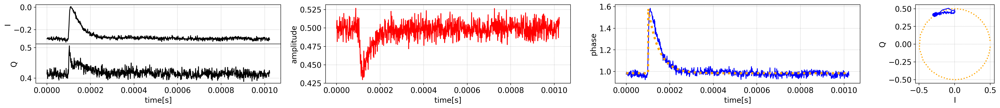

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0030_+031.577MHz_2018-0515-003704.rawdata


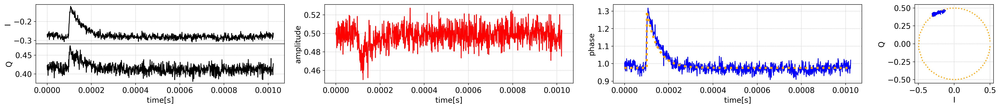

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0031_+031.577MHz_2018-0515-003804.rawdata


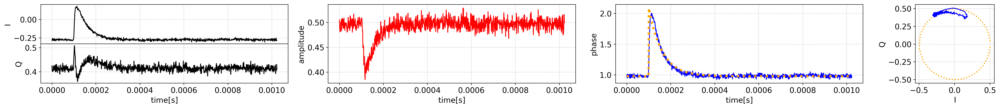

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0032_+031.577MHz_2018-0515-003830.rawdata


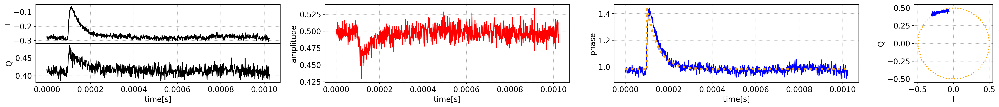

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0033_+031.577MHz_2018-0515-003843.rawdata


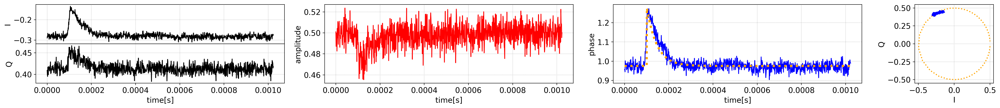

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0034_+031.577MHz_2018-0515-004027.rawdata


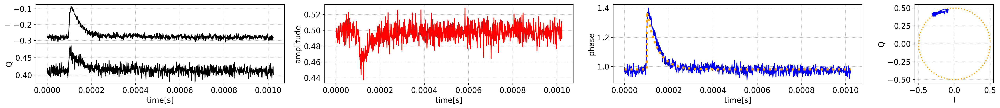

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0035_+031.577MHz_2018-0515-004106.rawdata


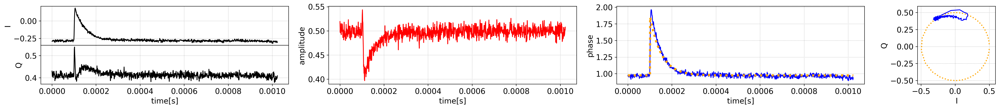

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0036_+031.577MHz_2018-0515-004133.rawdata


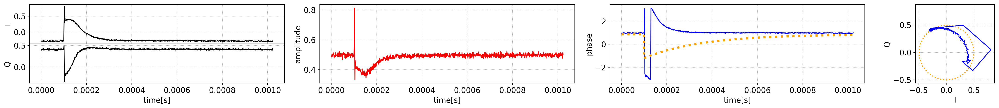

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0037_+031.577MHz_2018-0515-004359.rawdata


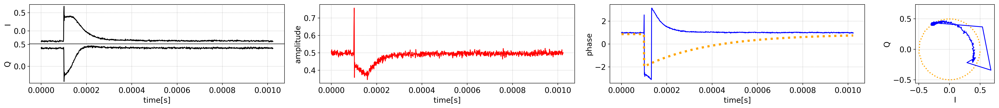

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0038_+031.577MHz_2018-0515-004547.rawdata


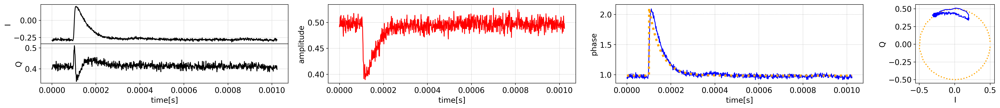

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0039_+031.577MHz_2018-0515-004709.rawdata


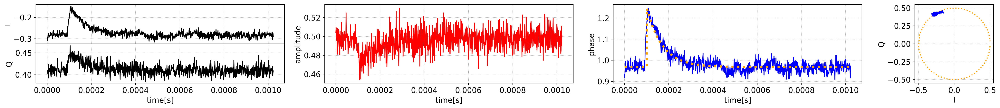

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0040_+031.577MHz_2018-0515-004727.rawdata


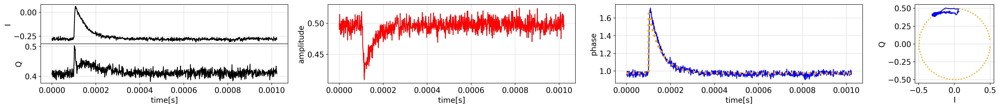

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0041_+031.577MHz_2018-0515-004753.rawdata


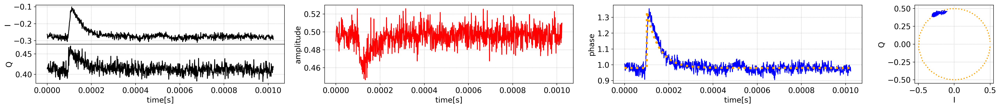

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0042_+031.577MHz_2018-0515-004758.rawdata


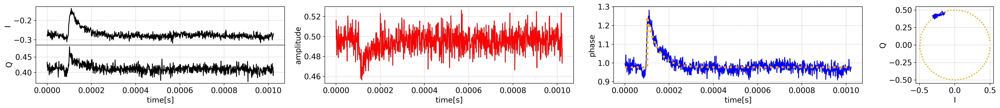

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0043_+031.577MHz_2018-0515-004832.rawdata


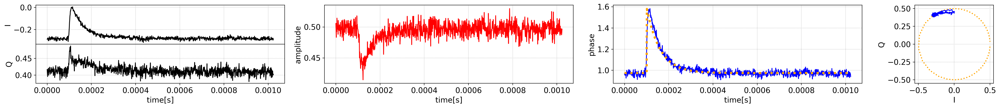

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0044_+031.577MHz_2018-0515-004909.rawdata


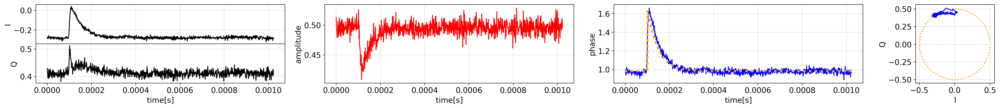

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0045_+031.577MHz_2018-0515-004914.rawdata


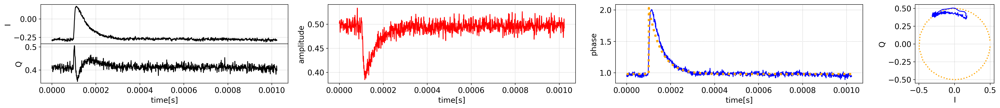

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0046_+031.577MHz_2018-0515-004950.rawdata


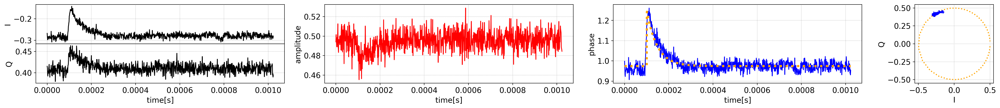

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0047_+031.577MHz_2018-0515-005019.rawdata


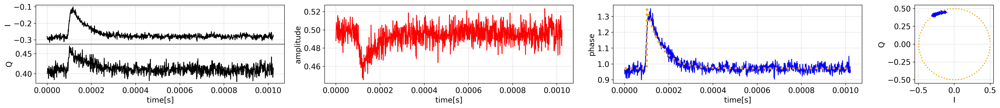

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0048_+031.577MHz_2018-0515-005029.rawdata


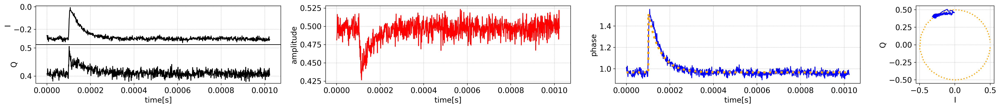

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0049_+031.577MHz_2018-0515-005049.rawdata


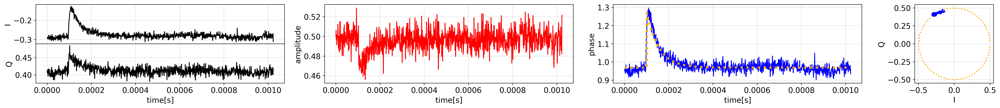

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0050_+031.577MHz_2018-0515-005230.rawdata


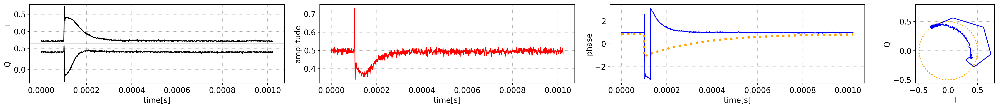

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0051_+031.577MHz_2018-0515-005300.rawdata


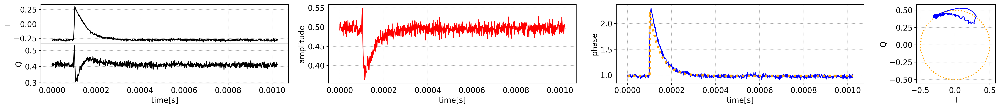

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0052_+031.577MHz_2018-0515-005317.rawdata


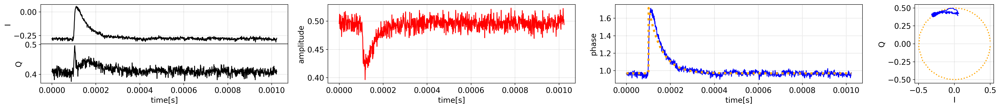

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0053_+031.577MHz_2018-0515-005424.rawdata


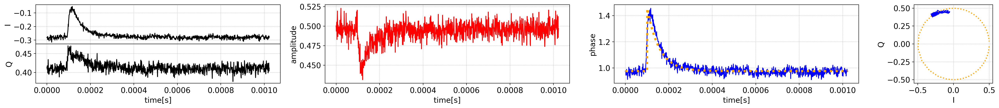

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0054_+031.577MHz_2018-0515-005436.rawdata


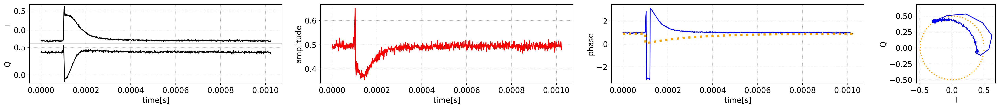

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0055_+031.577MHz_2018-0515-005457.rawdata


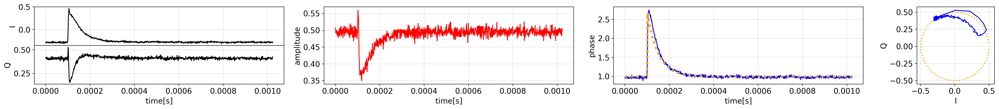

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0056_+031.577MHz_2018-0515-005531.rawdata


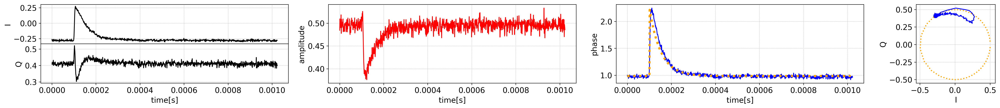

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0057_+031.577MHz_2018-0515-005714.rawdata


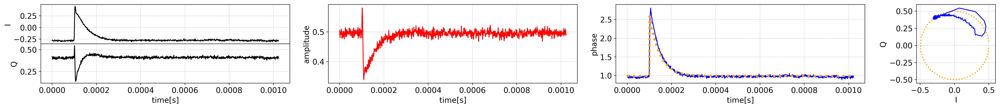

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0058_+031.577MHz_2018-0515-005934.rawdata


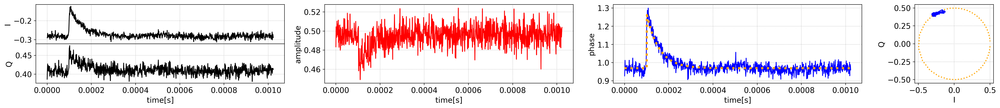

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0059_+031.577MHz_2018-0515-010016.rawdata


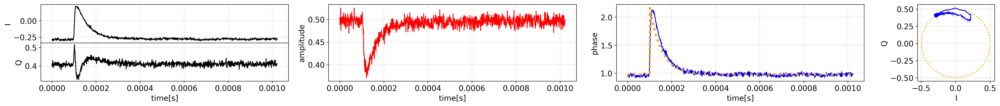

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0060_+031.577MHz_2018-0515-010031.rawdata


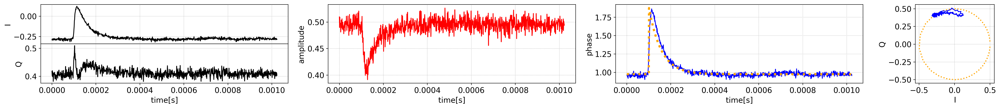

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0061_+031.577MHz_2018-0515-010052.rawdata


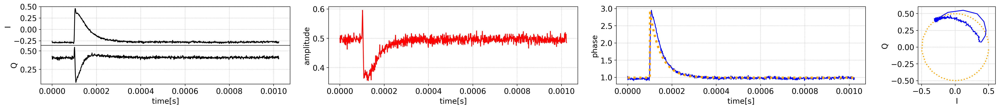

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0062_+031.577MHz_2018-0515-010107.rawdata


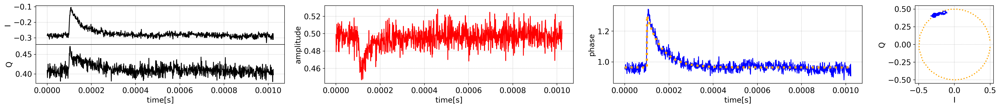

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0063_+031.577MHz_2018-0515-010156.rawdata


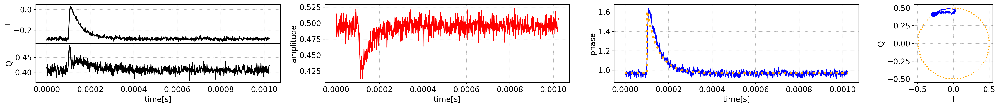

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0064_+031.577MHz_2018-0515-010222.rawdata


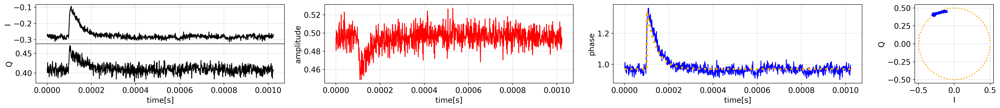

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0065_+031.577MHz_2018-0515-010243.rawdata


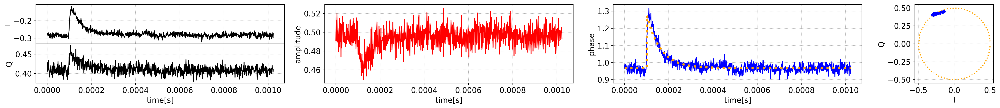

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0066_+031.577MHz_2018-0515-010317.rawdata


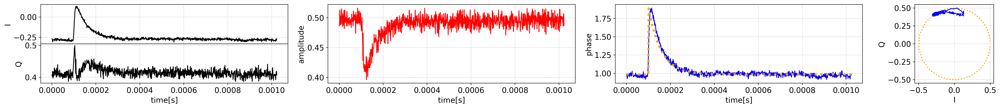

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0067_+031.577MHz_2018-0515-010350.rawdata


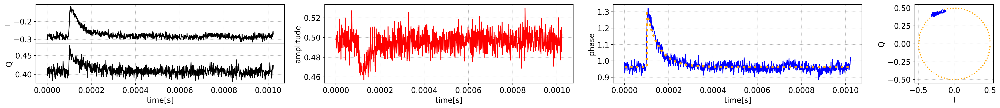

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0068_+031.577MHz_2018-0515-010401.rawdata


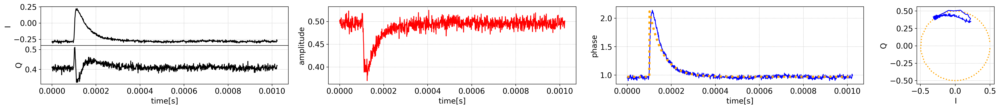

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0069_+031.577MHz_2018-0515-010432.rawdata


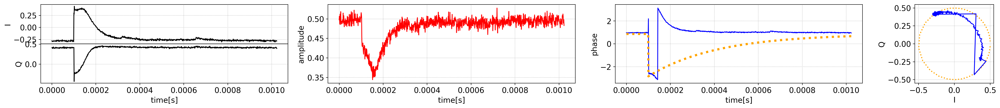

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0070_+031.577MHz_2018-0515-010530.rawdata


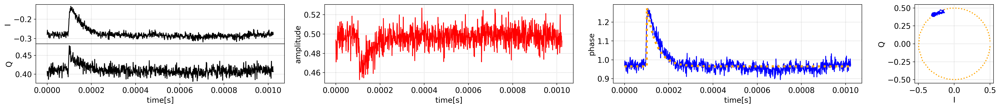

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0071_+031.577MHz_2018-0515-010625.rawdata


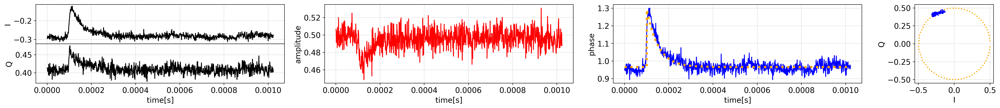

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0072_+031.577MHz_2018-0515-010630.rawdata


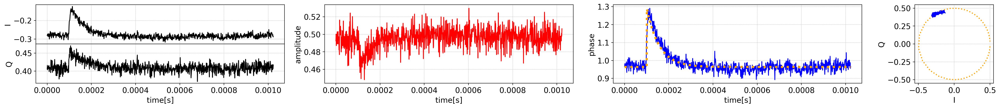

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0073_+031.577MHz_2018-0515-010640.rawdata


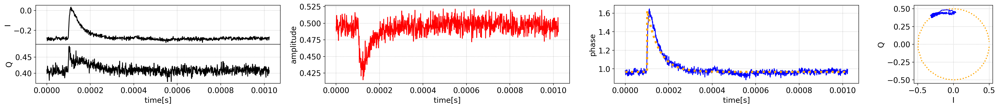

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0074_+031.577MHz_2018-0515-010809.rawdata


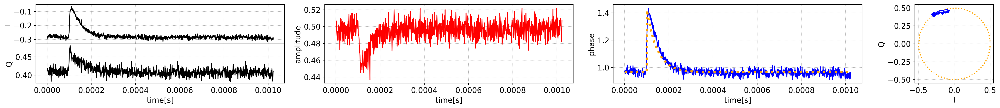

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0075_+031.577MHz_2018-0515-010841.rawdata


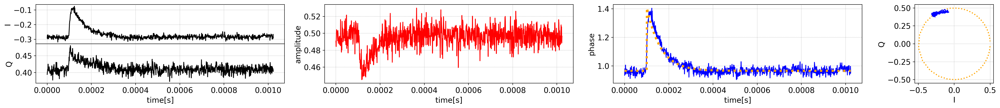

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0076_+031.577MHz_2018-0515-011004.rawdata


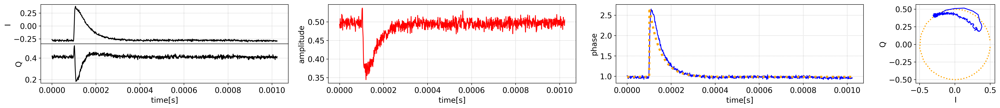

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0077_+031.577MHz_2018-0515-011038.rawdata


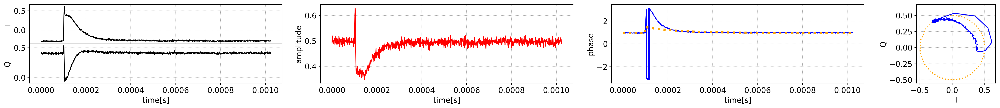

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0078_+031.577MHz_2018-0515-011055.rawdata


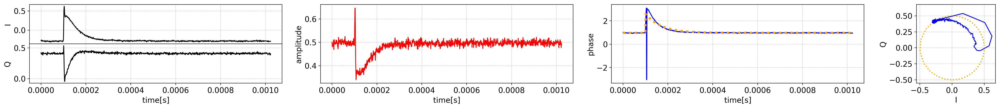

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0079_+031.577MHz_2018-0515-011110.rawdata


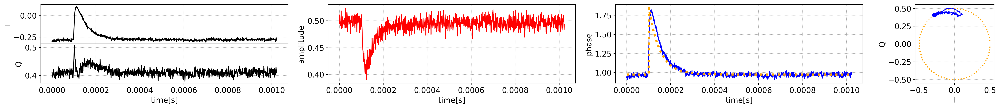

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0080_+031.577MHz_2018-0515-011135.rawdata


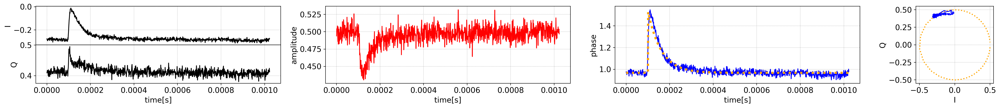

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0081_+031.577MHz_2018-0515-011144.rawdata


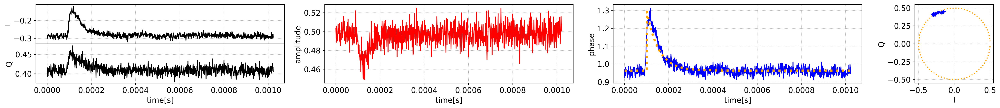

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0082_+031.577MHz_2018-0515-011148.rawdata


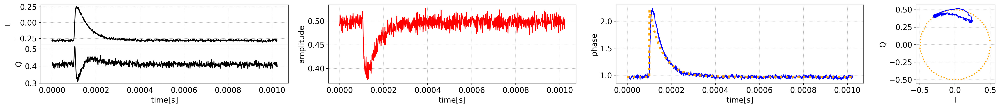

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0083_+031.577MHz_2018-0515-011217.rawdata


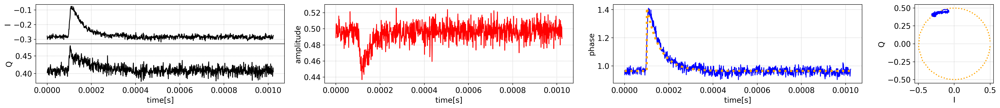

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0084_+031.577MHz_2018-0515-011227.rawdata


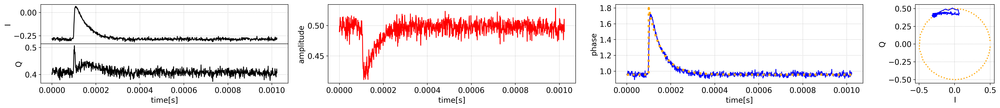

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0085_+031.577MHz_2018-0515-011234.rawdata


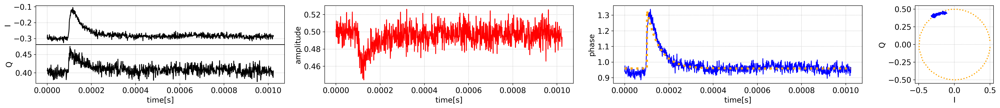

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0086_+031.577MHz_2018-0515-011246.rawdata


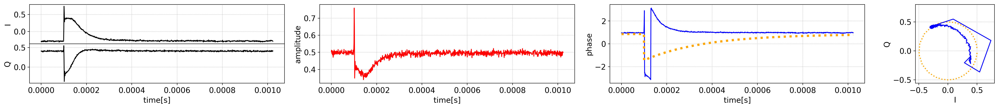

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0087_+031.577MHz_2018-0515-011303.rawdata


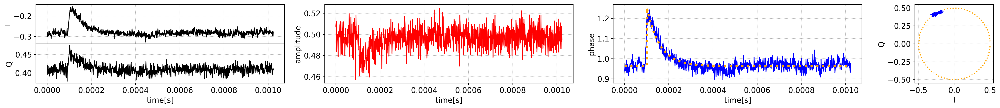

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0088_+031.577MHz_2018-0515-011342.rawdata


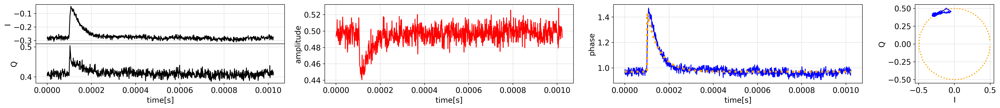

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0089_+031.577MHz_2018-0515-011348.rawdata


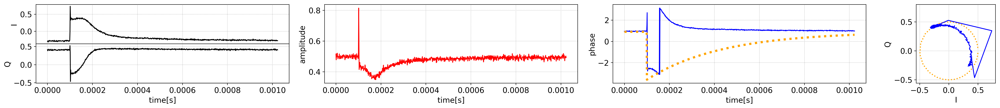

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0090_+031.577MHz_2018-0515-011400.rawdata


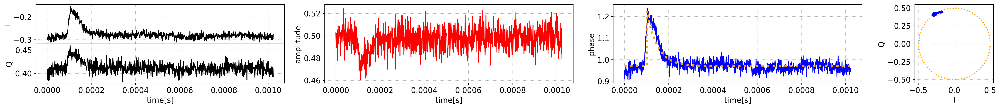

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0091_+031.577MHz_2018-0515-011408.rawdata


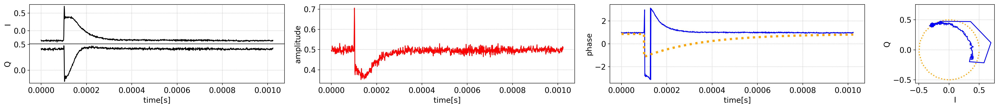

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0092_+031.577MHz_2018-0515-011444.rawdata


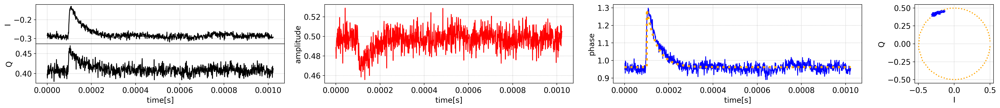

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0093_+031.577MHz_2018-0515-011530.rawdata


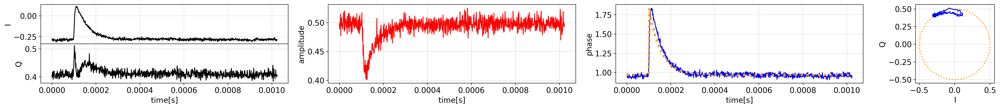

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0094_+031.577MHz_2018-0515-011550.rawdata


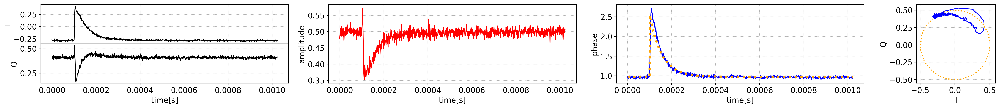

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0095_+031.577MHz_2018-0515-011608.rawdata


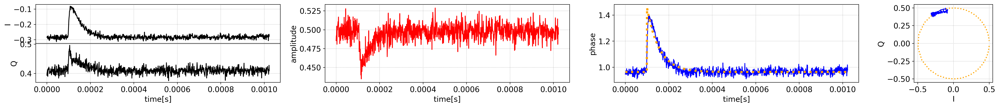

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0096_+031.577MHz_2018-0515-011632.rawdata


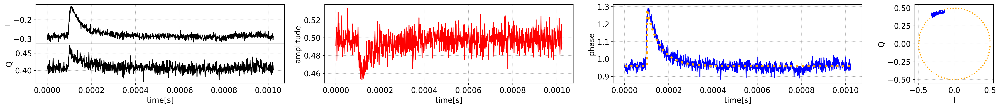

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0097_+031.577MHz_2018-0515-011748.rawdata


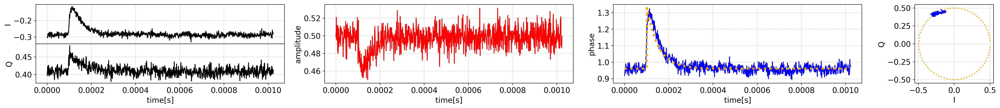

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0098_+031.577MHz_2018-0515-011816.rawdata


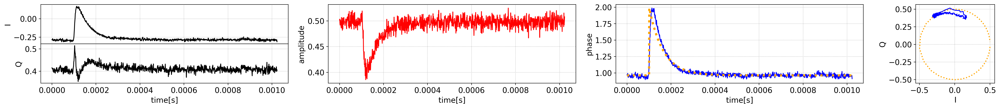

data_exams_mkid_pylibs/data_ex_darkSRONKIDS/data_2ch_trg_2018-0515-002105/tod_0.0uW_KID02_4.99GHz_trg0099_+031.577MHz_2018-0515-011908.rawdata


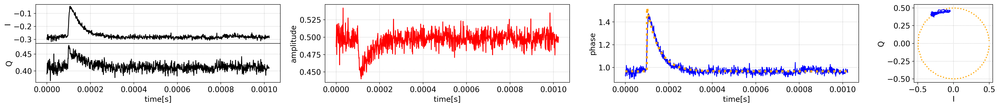

In [32]:
params = []
for ff in Trig_files[:100]:
    print(ff)
    todset = klib.readfile_tod('rhea',ff,-1,lo)
    trgkid = klib.kidana.KidAnalyzer(swp=kid.swp, tod=todset[0], ctod=todset[1])
    trgkid.fitIQ(silent=True)
    trgkid.fittrig(silent=True)
    klib.plotter.plotTOD(trgkid.tod,kind='rwmdata',trgft=trgkid.trgfitresult,swpdata=kid.swp)
    plt.show()
    params.append(trgkid.trgfitresult.params)

(<matplotlib.figure.Figure at 0x7fe74323d390>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7fe742bcea90>)

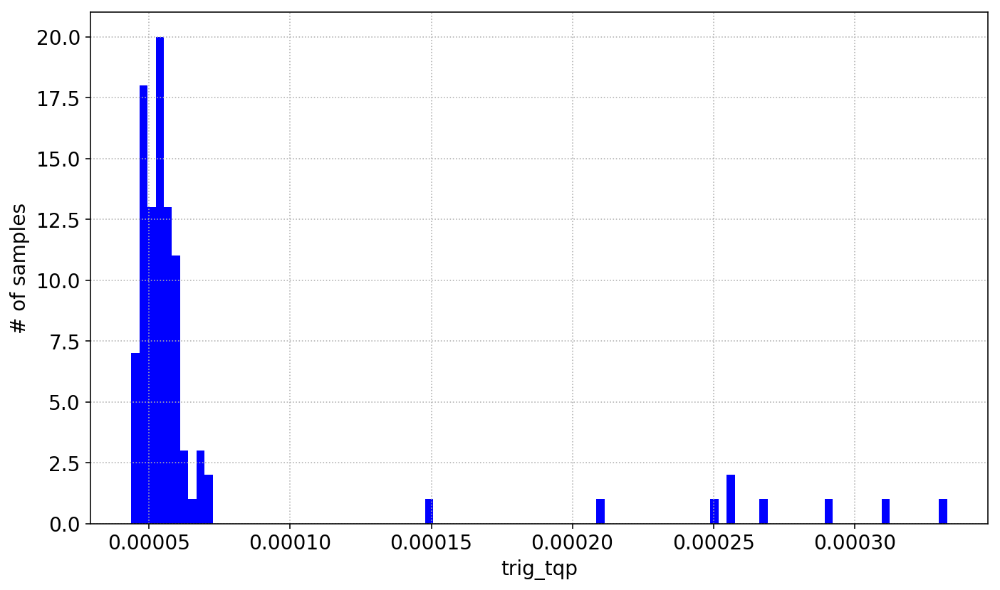

In [33]:
# Add results to sweep class
trgswp = klib.SweepMeas()
trgswp.sweepVar([p['t0'].value for p in params],'trig_t0',renew=True)
trgswp.sweepVar([p['tqp'].value for p in params],'trig_tqp',renew=True)
trgswp.sweepVar([p['n0'].value for p in params],'trig_n0',renew=True)
trgswp.sweepVar([p['bkgd'].value for p in params],'trig_bkgd',renew=True)
trgswp.hist_var(var='trig_tqp',bins=100,color='b')

## Trigger investigation with sweep class

In [34]:
trgswp = klib.SweepMeas()
trgswp.sweepVar_readfromfile('rhea',sfp0,lo,0,1,inpath_tod=Trig_files,dotrg=True,plotted=False,renew=True)

00 (   0.000 ) SWP: swp_0.0uW_KID02_4.99GHz_+030.070MHz_+033.070MHz_+000.010MHz_2018-0515-002105.rawdata
00 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0000_+031.577MHz_2018-0515-002150.rawdata
01 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0001_+031.577MHz_2018-0515-002208.rawdata
02 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0002_+031.577MHz_2018-0515-002322.rawdata
03 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0003_+031.577MHz_2018-0515-002335.rawdata
04 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0004_+031.577MHz_2018-0515-002339.rawdata
05 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0005_+031.577MHz_2018-0515-002353.rawdata
06 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0006_+031.577MHz_2018-0515-002432.rawdata
07 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0007_+031.577MHz_2018-0515-002438.rawdata
08 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0008_+031.577MHz_2018-0515-002456.rawdata
09 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0009_+031.577MHz_2018-0515-002520.rawdata
10 ( 

91 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0091_+031.577MHz_2018-0515-011408.rawdata
92 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0092_+031.577MHz_2018-0515-011444.rawdata
93 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0093_+031.577MHz_2018-0515-011530.rawdata
94 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0094_+031.577MHz_2018-0515-011550.rawdata
95 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0095_+031.577MHz_2018-0515-011608.rawdata
96 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0096_+031.577MHz_2018-0515-011632.rawdata
97 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0097_+031.577MHz_2018-0515-011748.rawdata
98 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0098_+031.577MHz_2018-0515-011816.rawdata
99 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0099_+031.577MHz_2018-0515-011908.rawdata
100 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0100_+031.577MHz_2018-0515-011958.rawdata
101 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0101_+031.577MHz_2018-0515-012015.rawdata
102 (   0.000 ) TOD

187 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0187_+031.577MHz_2018-0515-021326.rawdata
188 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0188_+031.577MHz_2018-0515-021338.rawdata
189 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0189_+031.577MHz_2018-0515-021343.rawdata
190 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0190_+031.577MHz_2018-0515-021359.rawdata
191 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0191_+031.577MHz_2018-0515-021404.rawdata
192 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0192_+031.577MHz_2018-0515-021412.rawdata
193 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0193_+031.577MHz_2018-0515-021557.rawdata
194 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0194_+031.577MHz_2018-0515-021623.rawdata
195 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0195_+031.577MHz_2018-0515-021648.rawdata
196 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0196_+031.577MHz_2018-0515-021727.rawdata
197 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0197_+031.577MHz_2018-0515-021732.rawdata
198 (   0.

284 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0284_+031.577MHz_2018-0515-030631.rawdata
285 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0285_+031.577MHz_2018-0515-030644.rawdata
286 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0286_+031.577MHz_2018-0515-030654.rawdata
287 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0287_+031.577MHz_2018-0515-030716.rawdata
288 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0288_+031.577MHz_2018-0515-030913.rawdata
289 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0289_+031.577MHz_2018-0515-031052.rawdata
290 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0290_+031.577MHz_2018-0515-031108.rawdata
291 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0291_+031.577MHz_2018-0515-031130.rawdata
292 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0292_+031.577MHz_2018-0515-031147.rawdata
293 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0293_+031.577MHz_2018-0515-031300.rawdata
294 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0294_+031.577MHz_2018-0515-031329.rawdata
295 (   0.

378 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0378_+031.577MHz_2018-0515-035437.rawdata
379 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0379_+031.577MHz_2018-0515-035506.rawdata
380 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0380_+031.577MHz_2018-0515-035544.rawdata
381 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0381_+031.577MHz_2018-0515-035608.rawdata
382 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0382_+031.577MHz_2018-0515-035641.rawdata
383 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0383_+031.577MHz_2018-0515-035715.rawdata
384 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0384_+031.577MHz_2018-0515-035802.rawdata
385 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0385_+031.577MHz_2018-0515-035846.rawdata
386 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0386_+031.577MHz_2018-0515-035857.rawdata
387 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0387_+031.577MHz_2018-0515-035908.rawdata
388 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0388_+031.577MHz_2018-0515-040020.rawdata
389 (   0.

474 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0474_+031.577MHz_2018-0515-044823.rawdata
475 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0475_+031.577MHz_2018-0515-044901.rawdata
476 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0476_+031.577MHz_2018-0515-044938.rawdata
477 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0477_+031.577MHz_2018-0515-045000.rawdata
478 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0478_+031.577MHz_2018-0515-045029.rawdata
479 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0479_+031.577MHz_2018-0515-045123.rawdata
480 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0480_+031.577MHz_2018-0515-045242.rawdata
481 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0481_+031.577MHz_2018-0515-045317.rawdata
482 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0482_+031.577MHz_2018-0515-045322.rawdata
483 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0483_+031.577MHz_2018-0515-045428.rawdata
484 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0484_+031.577MHz_2018-0515-045441.rawdata
485 (   0.

570 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0570_+031.577MHz_2018-0515-054334.rawdata
571 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0571_+031.577MHz_2018-0515-054356.rawdata
572 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0572_+031.577MHz_2018-0515-054414.rawdata
573 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0573_+031.577MHz_2018-0515-054438.rawdata
574 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0574_+031.577MHz_2018-0515-054613.rawdata
575 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0575_+031.577MHz_2018-0515-054618.rawdata
576 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0576_+031.577MHz_2018-0515-054707.rawdata
577 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0577_+031.577MHz_2018-0515-054712.rawdata
578 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0578_+031.577MHz_2018-0515-054757.rawdata
579 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0579_+031.577MHz_2018-0515-054819.rawdata
580 (   0.000 ) TOD: tod_0.0uW_KID02_4.99GHz_trg0580_+031.577MHz_2018-0515-054844.rawdata
581 (   0.

(<matplotlib.figure.Figure at 0x7fe7432b4630>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7fe742f98828>)

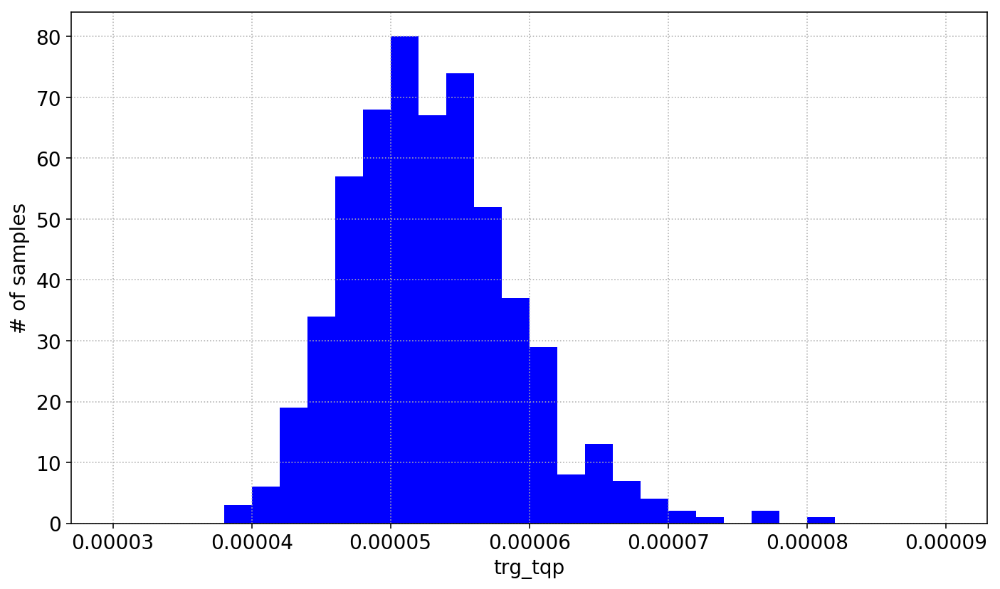

In [35]:
trgswp.hist_var('trg_tqp',bins=30,color='b', range=[30e-6,90e-6])